In [19]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt 
from PIL import Image
%matplotlib inline 

In [2]:
print('Number of train images:',len(os.listdir('/kaggle/input/train-data/train_data/images')))
print('Number of val images:',len(os.listdir('/kaggle/input/val-data/val_data/images')))

Number of train images: 92800
Number of val images: 23700


In [4]:
!pip install ultralytics

In [5]:
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.54 🚀 Python-3.7.12 torch-1.13.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
Setup complete ✅ (2 CPUs, 15.6 GB RAM, 4526.8/8062.4 GB disk)


In [7]:
!yolo task=detect mode=train data=/kaggle/input/yaml-data/retail.yaml model=yolov8n.pt epochs=6 batch=32 mixup=0.5 copy_paste=0.2 flipud=0.2 shear=5 label_smoothing=0.01 degrees=5

Ultralytics YOLOv8.0.54 🚀 Python-3.7.12 torch-1.13.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/input/yaml-data/retail.yaml, epochs=6, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynamic=

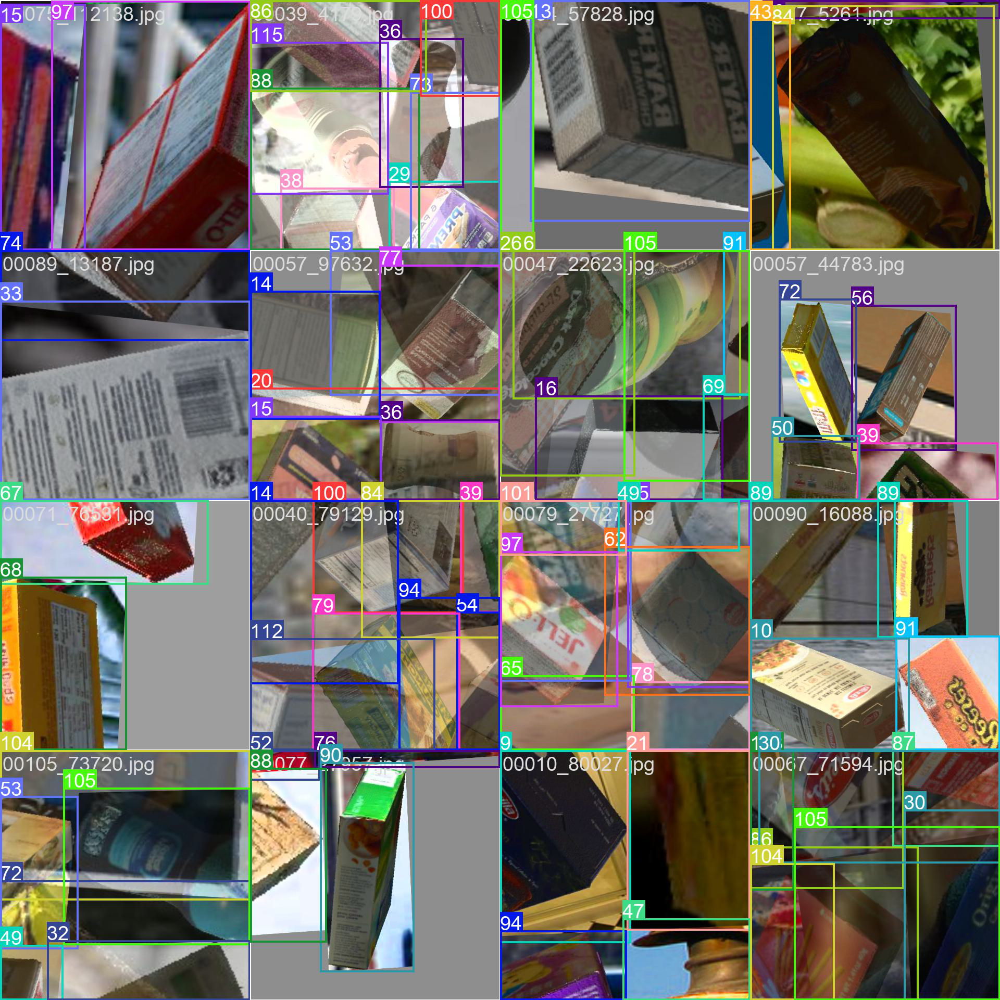

In [8]:
Image.open('/kaggle/working/runs/detect/train2/train_batch0.jpg')

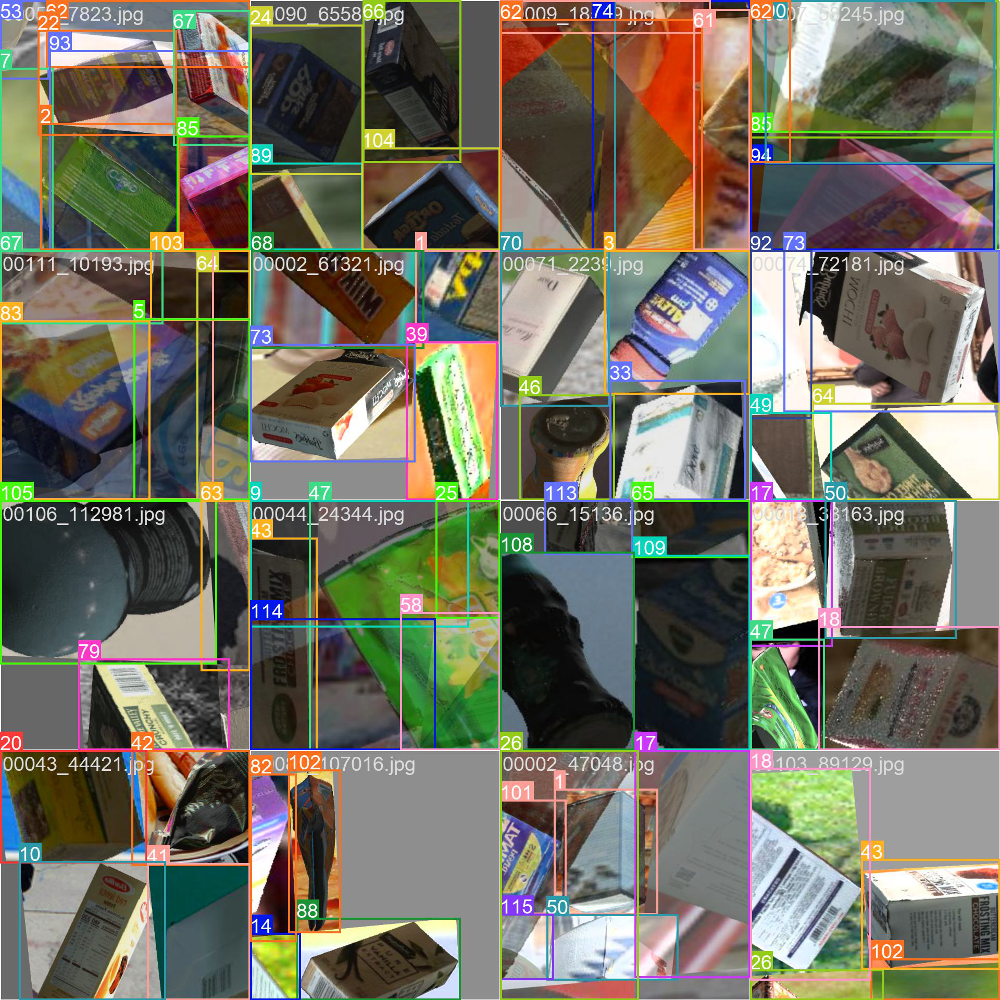

In [9]:
Image.open('/kaggle/working/runs/detect/train2/train_batch1.jpg')

In [10]:
TRAIN_DIR = '/kaggle/working/runs/detect/train2'
for dir in os.listdir(TRAIN_DIR):
    print(dir)

confusion_matrix.png
val_batch0_labels.jpg
val_batch1_labels.jpg
labels.jpg
R_curve.png
P_curve.png
results.png
labels_correlogram.jpg
val_batch0_pred.jpg
val_batch2_labels.jpg
F1_curve.png
results.csv
train_batch2.jpg
train_batch0.jpg
PR_curve.png
weights
args.yaml
train_batch1.jpg
events.out.tfevents.1679147261.1c6932abd856.1237.0
val_batch2_pred.jpg
val_batch1_pred.jpg


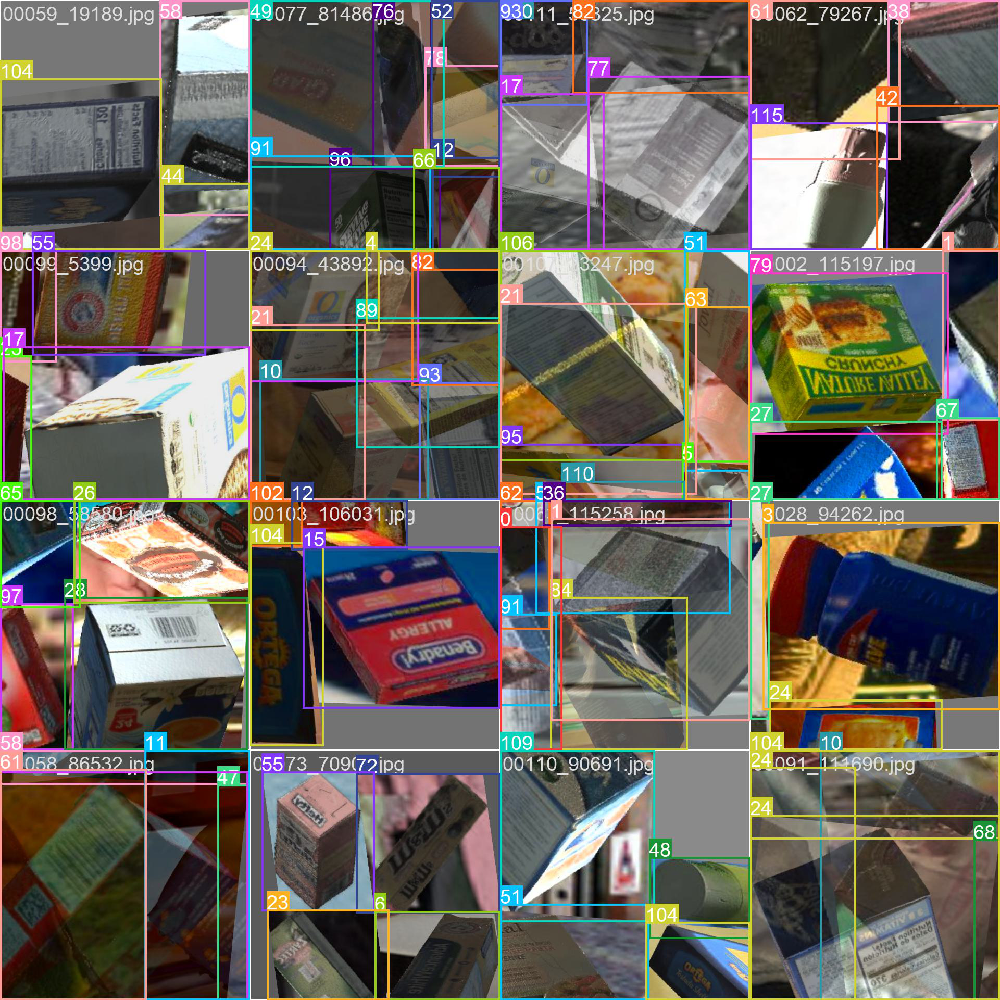

In [11]:
Image.open('/kaggle/working/runs/detect/train2/train_batch2.jpg')

In [12]:
!yolo task=detect mode=val data=/kaggle/input/yaml-data/retail.yaml model=/kaggle/working/runs/detect/train2/weights/best.pt 


Ultralytics YOLOv8.0.54 🚀 Python-3.7.12 torch-1.13.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
Model summary (fused): 168 layers, 3509060 parameters, 0 gradients, 10.4 GFLOPs
val: Scanning /kaggle/input/val-data/val_data/labels... 23700 images, 0 backgrou
val: WARNING ⚠️ Cache directory /kaggle/input/val-data/val_data is not writeable, cache not saved.
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all      23700      23700      0.993      0.992      0.995      0.995
      Advil Liquid Gel      23700        215      0.986      0.961      0.994      0.994
         Advil Tablets      23700        215      0.955      0.977      0.993      0.993
          Alcohol Pads      23700        215       0.99          1      0.995      0.995
              Aleve PM      23700        215      0.997      0.995      0.995      0.994
         Aleve Tablets      23700        215      0.991          1      0.995      0.995
All Free and Clear Pods      237

In [13]:
VAL_DIR = '/kaggle/working/runs/detect/val'
for dir in os.listdir(VAL_DIR):
    print(dir)

confusion_matrix.png
val_batch0_labels.jpg
val_batch1_labels.jpg
R_curve.png
P_curve.png
val_batch0_pred.jpg
val_batch2_labels.jpg
F1_curve.png
PR_curve.png
val_batch2_pred.jpg
val_batch1_pred.jpg


## Precision-Recall Curve

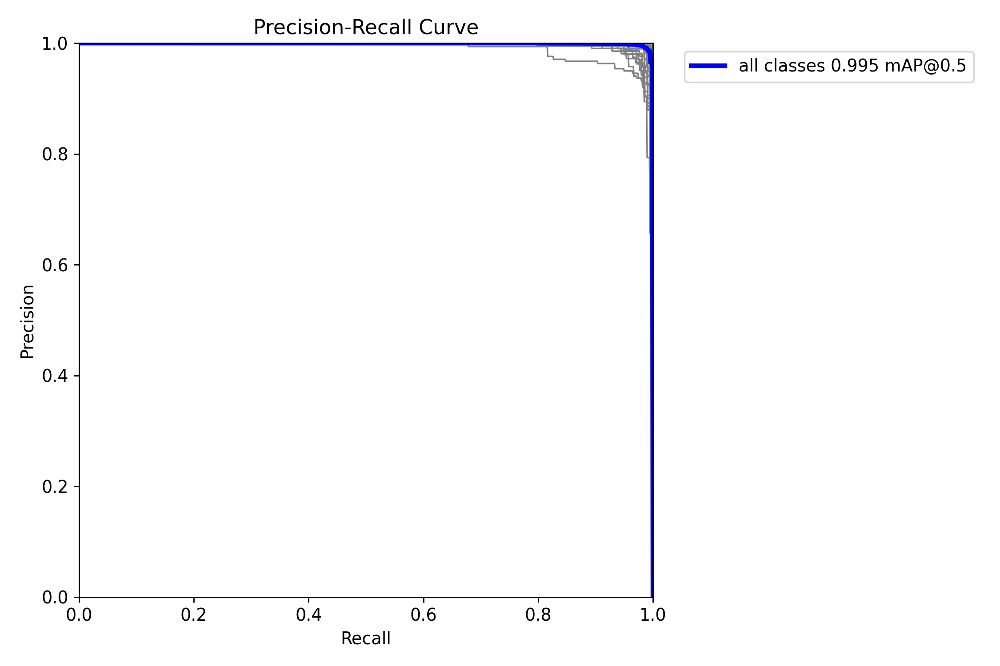

In [14]:
Image.open('/kaggle/working/runs/detect/val/PR_curve.png')

## F1 Curve

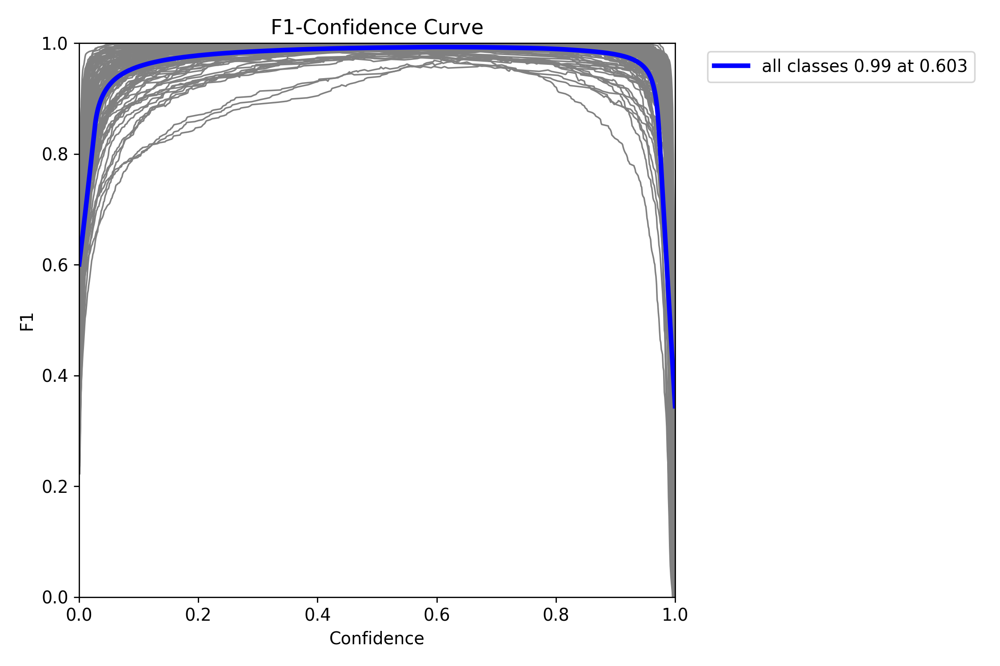

In [15]:
Image.open('/kaggle/working/runs/detect/val/F1_curve.png')

## Visualise Classes

In [22]:
classes = {0: 'Advil Liquid Gel',
  1: 'Advil Tablets',
  2: 'Alcohol Pads',
  3: 'Aleve PM',
  4: 'Aleve Tablets',
  5: 'All Free and Clear Pods',
  6: 'Arm and Hammer Toothpaste',
  7: 'Bandaid Variety',
  8: 'Banza',
  9: 'Barilla Penne',
  10: 'Barilla Red Lentil',
  11: 'Barilla Rotini Pasta',
  12: 'Barnums Animal Crackers',
  13: 'Bayer Chewable 3 Pack',
  14: 'Bayer Lower Dose',
  15: 'Benadryl Allergy Tablets', 
  16: 'Biore',
  17: 'Brown Rice', 
  18: 'Bumble Bee Tuna',
  19: 'Cane Sugar',
  20: 'Chamomile Tea',
  21: 'Chicken Bouillon',
  22: 'Children_s Allegra Allergy',
  23: 'Children_s Zyrtec',
  24: 'Chocolate Fudge Poptart',
  25: 'Chocolate Pocky',
  26: 'Chocolate Strawberries',
  27: 'Claratin Chewable',
  28: 'Coffee Mate Creamer', 
  29: 'Crackers and Cheese', 
  30: 'Cream Cheese', 
  31: 'Crest White Strips', 
  32: 'Dove Cool Moisturizer', 
  33: 'Dove Soap Sensitive', 
  34: 'Dove Body Wash', 
  35: 'Downy Odor Defense', 
  36: 'Dreft Scent Beads', 
  37: 'Dry Eye Relief', 
  38: 'Excedrine Migraine', 
  39: 'Extra Spearmint', 
  40: 'Flonase', 
  41: 'Flow Flex Covid 19 Test', 
  42: 'French Roast Starbucks', 
  43: 'Frosting Mix Chocolate', 
  44: 'Fudge Oreos', 
  45: 'Funfetti Cake', 
  46: 'Gain Fireworks Scent Beads', 
  47: 'Gain Flings', 
  48: 'Garnier Shampoo', 
  49: 'Glad Drawstring Trash Bag', 
  50: 'Gluten Free Brownies', 
  51: 'Gluten Free Pasta', 
  52: 'Gournay Cheese', 
  53: 'Healthy Choice Chicken Alfredo', 
  54: 'Heavy Duty Forks', 
  55: 'Hefty Small Trash Bags', 
  56: 'Hello Toothpaste', 
  57: 'Honey Maid Graham Crackers', 
  58: 'Ice Cream Sandwiches', 
  59: 'Ice Breakers Ice Cubes', 
  60: 'Jello Vanilla Pudding', 
  61: 'Kerrygold Butter', 
  62: 'Kleenex', 
  63: 'Lipton Noodle Soup', 
  64: "Mac 'n' Cheese Shells", 
  65: 'Macaroni and Cheese Original', 
  66: 'Matzo Balls', 
  67: 'McCormick Natures Food Coloring',
  68: 'Milk Duds',
  69: 'Minute Tapioca',
  70: 'Miss Dior',
  71: 'Mixed Berries Hibiscus Tea',
  72: 'M&Ms Peanuts',
  73: 'Mochi Ice Cream', 
  74: 'Motrin Ib Migraine', 
  75: 'Mr Clean', 
  76: 'Nasacort Allergy',
  77: 'Nasal Decongestant',
  78: 'Nasal Strip', 
  79: 'Nature Valley Granola Bars', 
  80: 'Nintendo Switch Controllers', 
  81: 'Onion Soup Dip Mix',
  82: 'Pedialyte Powder',
  83: 'Peets Keurig', 
  84: "Peet's Coffee Grounds Dark Roast", 
  85: 'Playtex Sport', 
  86: 'Pocky Strawberry', 
  87: 'Pork Sausage', 
  88: 'Pure Vanilla Extract', 
  89: 'Raisinets', 
  90: 'Ranch Seasoning', 
  91: "Reese's Pieces", 
  92: 'Rewetting Drops Contact Solution', 
  93: 'Smores Poptarts',
  94: 'Snuggle Dryer Sheets', 
  95: 'Sour Patch Kids', 
  96: 'Stevia in the Raw',
  97: 'Strawberry Jello', 
  98: 'Stress Relief Spray All Natural', 
  99: 'Sunmaid Raisins', 
  100: 'Swiss Miss Hot Chocolate', 
  101: 'Tampax', 
  102: 'Tide Pods', 
  103: 'Toothpicks', 
  104: 'Tostada Shells', 
  105: 'Total Home Scent Boos', 
  106: 'Tussin', 
  107: 'Tylenol Arthritis', 
  108: 'Unstoppables', 
  109: 'Vapo Rub',
  110: "Vick's Pure Zzz's",
  111: 'Vinyl Gloves',
  112: 'Visine Red Eye Hydrating Comfort', 
  113: 'Whoppers', 
  114: 'Wild Strawberry Tea',
  115: 'Woolite Delicates _Attempt_'}

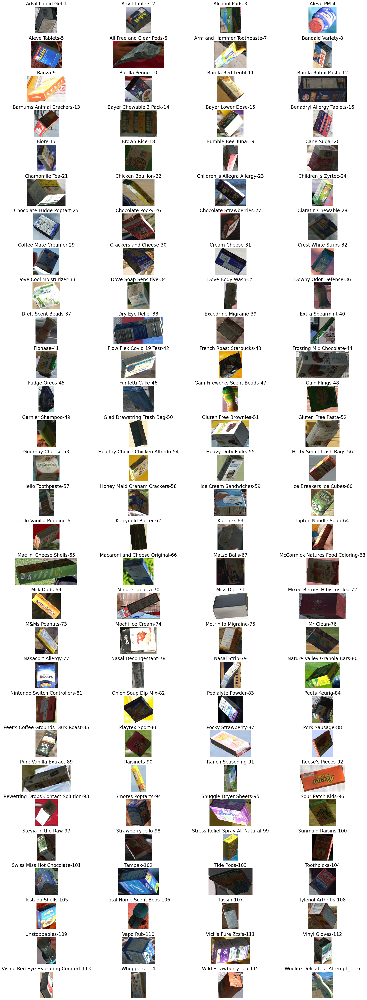

In [23]:
# Set up the plot
path = '/kaggle/input/val-data/val_data/images'
fig, axs = plt.subplots(29, 4, figsize=(24, 60))
# fig, axs = plt.subplots(29, 4, figsize=(12, 30))
axs = axs.ravel()
list_path = os.listdir(path)

rand_int = random.randint(0, 20)

for class_id in range(1, 117):
    img_path = [f for f in list_path if f.startswith(f'{str(class_id).zfill(5)}_')][rand_int]
    img = plt.imread(os.path.join(path, img_path))

    # Plot the image
    axs[class_id-1].imshow(img, cmap='gray')
    axs[class_id-1].axis('off')
    axs[class_id-1].set_title(f"{classes[class_id-1]}-{class_id}", fontsize=20)

# Display the plot
plt.tight_layout()
plt.show()

In [24]:
def val_predict(label_pth, pred_path):
    img = Image.open(label_pth)
    width, height = img.size
    width, height
    resized_lbl = img.resize((width, int(height*2)))

    img = Image.open(pred_path)
    width, height = img.size
    width, height
    resized_pred = img.resize((width, int(height*2)))
    return resized_lbl, resized_pred

## Batch 0

In [25]:
lbl_pth = '/kaggle/working/runs/detect/val/val_batch0_labels.jpg'
pred_pth = '/kaggle/working/runs/detect/val/val_batch0_pred.jpg'

### Labels for Batch 0

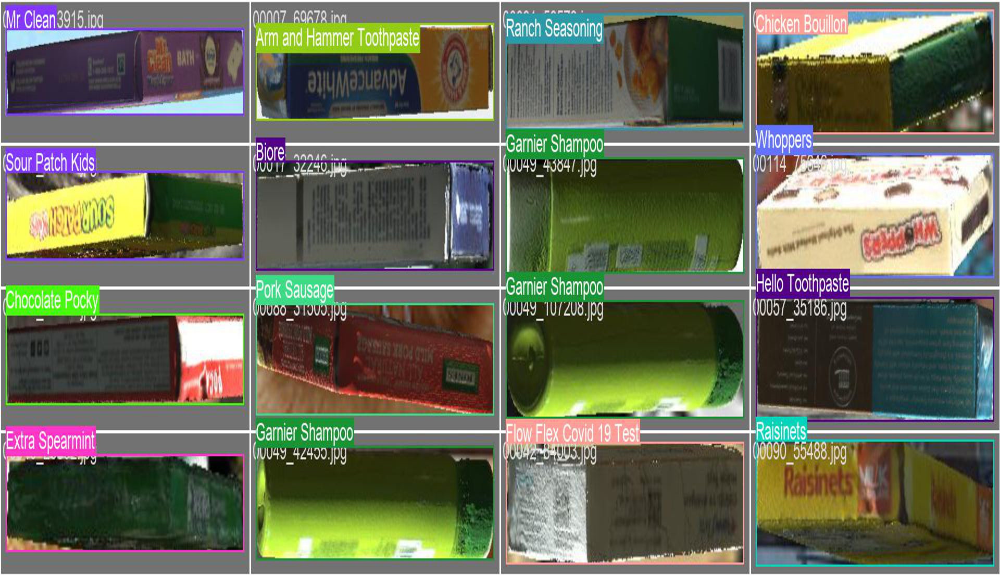

In [26]:
val_predict(lbl_pth, pred_pth)[0]

### Predictions for batch 0

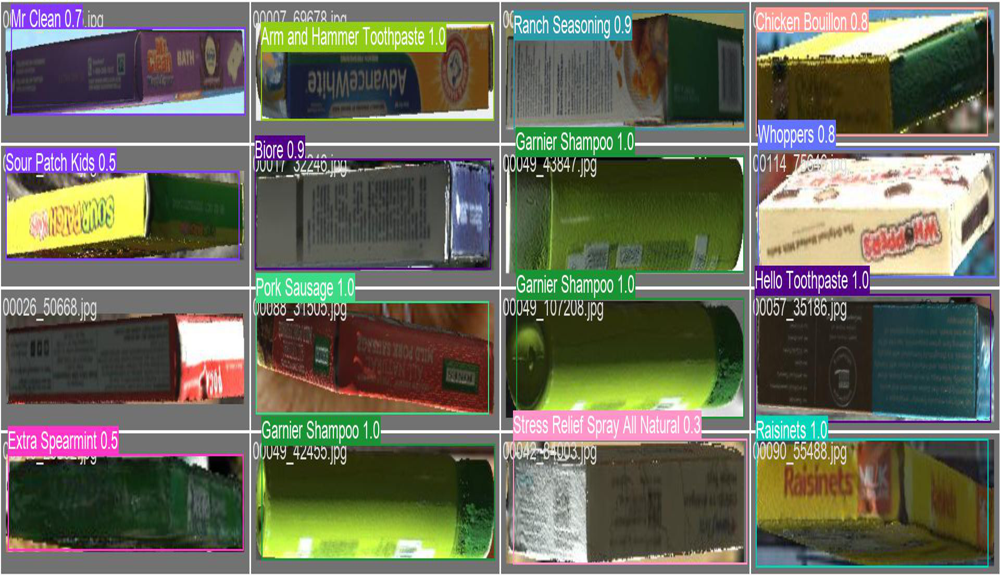

In [27]:
val_predict(lbl_pth, pred_pth)[1]

## Batch 1

In [28]:
lbl_pth = '/kaggle/working/runs/detect/val/val_batch1_labels.jpg'
pred_pth = '/kaggle/working/runs/detect/val/val_batch1_pred.jpg'

### Labels for Batch 1

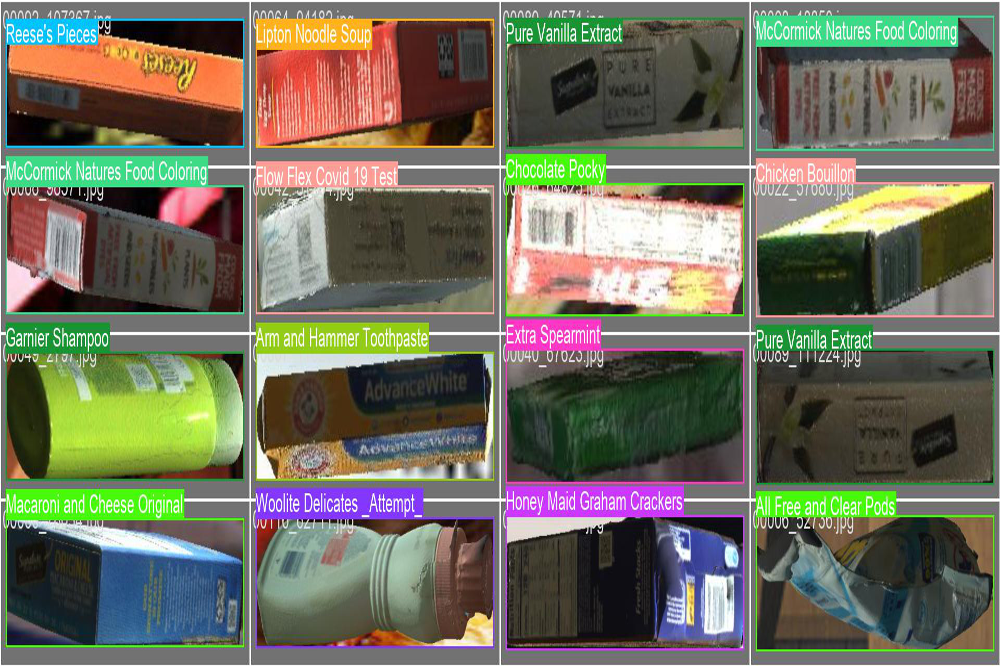

In [29]:
val_predict(lbl_pth, pred_pth)[0]

### Predictions for Label 1

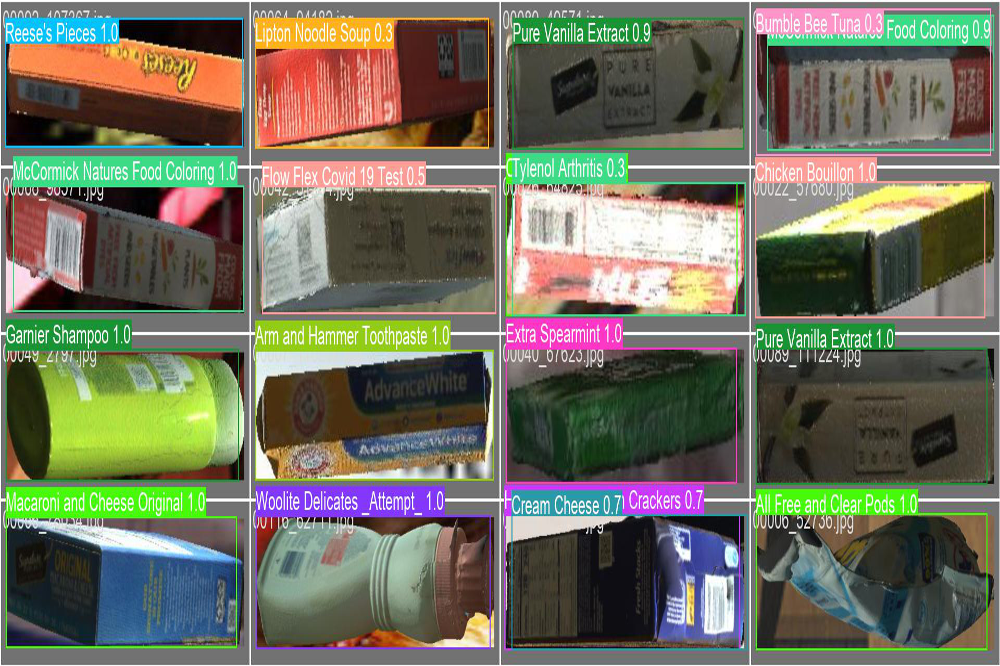

In [30]:
val_predict(lbl_pth, pred_pth)[1]

## Batch 2

In [32]:
lbl_pth = '/kaggle/working/runs/detect/val/val_batch2_labels.jpg'
pred_pth = '/kaggle/working/runs/detect/val/val_batch2_pred.jpg'

### Labels for Batch 2

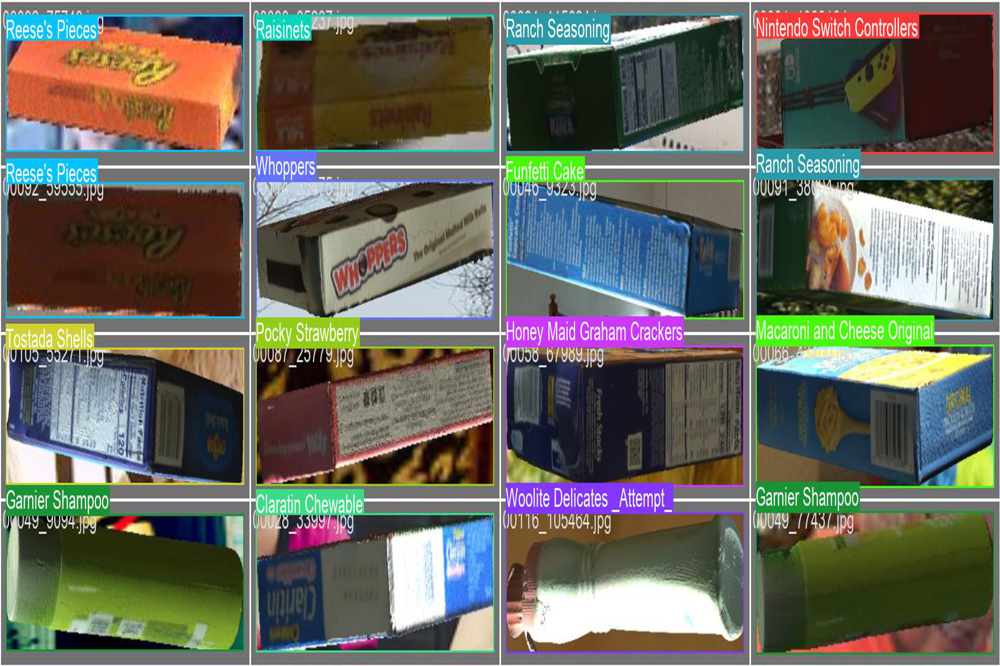

In [33]:
val_predict(lbl_pth, pred_pth)[0]

### Predictions for batch 2

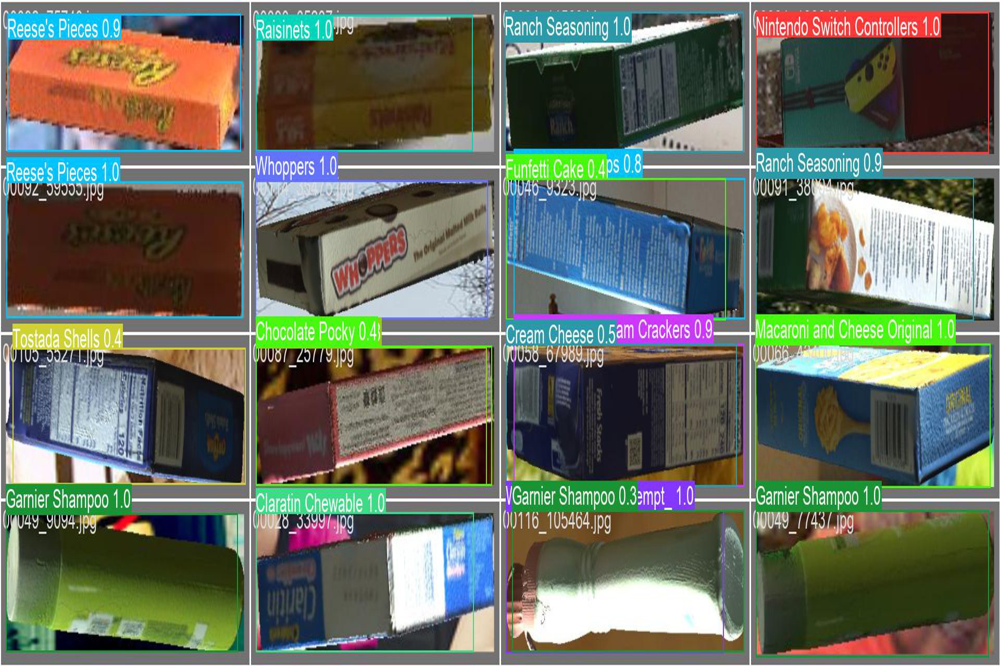

In [34]:
val_predict(lbl_pth, pred_pth)[1]